In [1]:
!pip install mealpy >> installation.txt

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import xgboost as xgb

from xgboost import XGBClassifier
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from mealpy.optimizer import Optimizer
from scipy.io import arff
from mealpy import FloatVar
from math import gamma

In [3]:
df = pd.read_csv(r'/kaggle/input/final-dataset-for-embedding-combination/ConvE_10_with_fr.csv')
df

,Unnamed: 0,Folder_name,Feature_name,x1,x2,x3,x4,x5,x6,x7,...,k8,k9,k10,Open,High,Low,Close,Prev. Close,Change,% Change
0,0,ABG Shipyard Limited,2013,0.95,0.40,0.003346,2.27,0.707756,0.017817,18.88,...,3.331443,0.0,3.539602,19.204890,20.043685,18.323994,19.321036,19.295528,0.025458,0.265418
1,4,ANG Industries Limited,2013,1.14,0.51,0.060725,1.53,0.523116,0.138180,51.51,...,3.897995,0.0,3.638812,19.204890,20.043685,18.323994,19.321036,19.295528,0.025458,0.265418
2,5,ANG Industries Limited,2015,1.08,0.49,0.037860,1.72,0.562869,0.151222,51.31,...,2.369548,0.0,2.675434,17.999170,18.787287,16.485577,18.010405,18.001943,0.008623,0.242227
3,6,ANG Industries Limited,2016,0.96,0.41,0.020800,1.77,0.601283,0.147791,58.66,...,3.116590,0.0,3.773186,15.342440,15.849919,14.075262,15.325655,15.342440,-0.016573,-0.024677
4,7,ANG Industries Limited,2017,0.31,0.17,0.004391,-2.81,1.076724,0.164016,56.30,...,3.647412,0.0,4.323845,12.948232,13.488902,11.567490,12.961799,12.948232,0.013740,0.197033
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89,46,Jaypee Infratech Limited,2020,0.70,0.08,0.006177,-4.37,0.776451,0.127856,7.84,...,3.670827,0.0,3.562300,25.511968,26.398444,23.216697,25.516386,25.699317,-0.183574,-0.352289
90,47,Jaypee Infratech Limited,2021,0.63,0.08,0.014797,-1.72,0.877271,0.128827,3.30,...,3.982584,0.0,3.381750,17.841734,18.662440,16.379446,17.841391,17.841734,-0.000363,0.163992
91,41,Jenson & Nicholson (India) Limited,2016,0.03,0.02,0.006709,-0.23,23.069427,1.188889,240.19,...,2.130456,0.0,2.874489,15.342440,15.849919,14.075262,15.325655,15.342440,-0.016573,-0.024677
92,42,Jenson & Nicholson (India) Limited,2017,0.01,0.01,0.002659,-0.22,34.559140,1.213938,74.81,...,3.347911,0.0,3.853860,12.948232,13.488902,11.567490,12.961799,12.948232,0.013740,0.197033


In [4]:
df.columns

Index(['Unnamed: 0', 'Folder_name', 'Feature_name', 'x1', 'x2', 'x3', 'x4',
       'x5', 'x6', 'x7', 'x8', 'x9', 'x10', 'x11', 'x12', 'x13', 'x14', 'x15',
       'x16', 'x17', 'x18', 'x19', 'x20', 'x21', 'x22', 'x23', 'x24', 'x25',
       'x26', 'x27', 'x28', 'x29', 'x30', 'x31', 'x32', 'x33', 'x34', 'x35',
       'x36', 'x37', 'x38', 'x39', 'x40', 'x41', 'x42', 'x43', 'x44', 'x45',
       'x46', 'x47', 'x48', 'x49', 'x50', 'x51', 'x52', 'x53', 'x54', 'x55',
       'x56', 'x57', 'x58', 'x59', 'x60', 'x61', 'x62', 'x63', 'x64', 'x65',
       'x66', 'Label', 'Bankruptcy', 'path', 'k1', 'k2', 'k3', 'k4', 'k5',
       'k6', 'k7', 'k8', 'k9', 'k10', 'Open ', 'High ', 'Low ', 'Close ',
       'Prev. Close ', 'Change ', '% Change '],
      dtype='object')

In [5]:
drop_col = ['Unnamed: 0', 'Label', 'Bankruptcy', 'Folder_name', 'Feature_name', 'path']
df = df.sort_values(by=["Folder_name", "Feature_name"])
df.dropna(inplace=True)
X = df.drop(drop_col, axis=1)
y = df['Label']

In [6]:
print('original feature len', len(df.columns))
print('original features', (df.columns))
print(df.head())

original feature len 89
original features Index(['Unnamed: 0', 'Folder_name', 'Feature_name', 'x1', 'x2', 'x3', 'x4',
       'x5', 'x6', 'x7', 'x8', 'x9', 'x10', 'x11', 'x12', 'x13', 'x14', 'x15',
       'x16', 'x17', 'x18', 'x19', 'x20', 'x21', 'x22', 'x23', 'x24', 'x25',
       'x26', 'x27', 'x28', 'x29', 'x30', 'x31', 'x32', 'x33', 'x34', 'x35',
       'x36', 'x37', 'x38', 'x39', 'x40', 'x41', 'x42', 'x43', 'x44', 'x45',
       'x46', 'x47', 'x48', 'x49', 'x50', 'x51', 'x52', 'x53', 'x54', 'x55',
       'x56', 'x57', 'x58', 'x59', 'x60', 'x61', 'x62', 'x63', 'x64', 'x65',
       'x66', 'Label', 'Bankruptcy', 'path', 'k1', 'k2', 'k3', 'k4', 'k5',
       'k6', 'k7', 'k8', 'k9', 'k10', 'Open ', 'High ', 'Low ', 'Close ',
       'Prev. Close ', 'Change ', '% Change '],
      dtype='object')
   Unnamed: 0             Folder_name  Feature_name    x1    x2        x3  \
0           0    ABG Shipyard Limited          2013  0.95  0.40  0.003346   
1           4  ANG Industries Limited        

In [7]:
numeric_only = df.describe().columns
df.describe()

,Unnamed: 0,Feature_name,x1,x2,x3,x4,x5,x6,x7,x8,...,k8,k9,k10,Open,High,Low,Close,Prev. Close,Change,% Change
count,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,...,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000
mean,48.712766,2018.489362,1.722979,1.175532,0.272789,6.462128,1.223905,0.167203,52.929255,6.011116,...,1.634810,1.448114,1.776176,17.111229,17.825825,15.610730,17.137938,17.138194,-0.000232,0.122708
std,28.812565,2.605803,1.863132,1.651056,0.763100,46.933882,4.295959,0.305868,53.157638,11.313087,...,1.657006,2.075770,1.785617,3.941243,4.094648,3.640952,3.955928,3.994483,0.095279,0.287046
min,0.000000,2012.000000,0.010000,0.010000,0.000045,-52.050000,0.005373,0.000836,0.000000,0.408903,...,0.000000,0.000000,0.000000,12.444787,12.918303,11.567490,12.444370,12.444787,-0.183574,-0.352289
25%,24.250000,2017.000000,0.722500,0.302500,0.008128,0.000000,0.240103,0.016408,6.820000,1.035058,...,0.000000,0.000000,0.000000,13.394924,13.924419,12.156342,13.407075,13.395811,-0.016573,-0.024677
50%,48.500000,2018.000000,1.155000,0.640000,0.037404,0.290000,0.362244,0.057861,43.840000,1.840619,...,2.127528,0.000000,2.612373,16.359275,17.048378,14.857233,16.342896,16.359275,0.001996,0.132621
75%,72.750000,2020.000000,1.805000,1.070000,0.117092,1.147500,0.588824,0.135842,80.907500,4.454373,...,3.308279,3.047281,3.399116,19.232581,20.262817,17.555142,19.402197,19.241812,0.013740,0.197033
max,98.000000,2023.000000,10.000000,8.000000,4.528798,407.970000,34.559140,1.567138,240.190000,58.019097,...,4.656619,6.599966,5.185453,25.511968,26.398444,23.216697,25.516386,25.699317,0.187652,0.708502


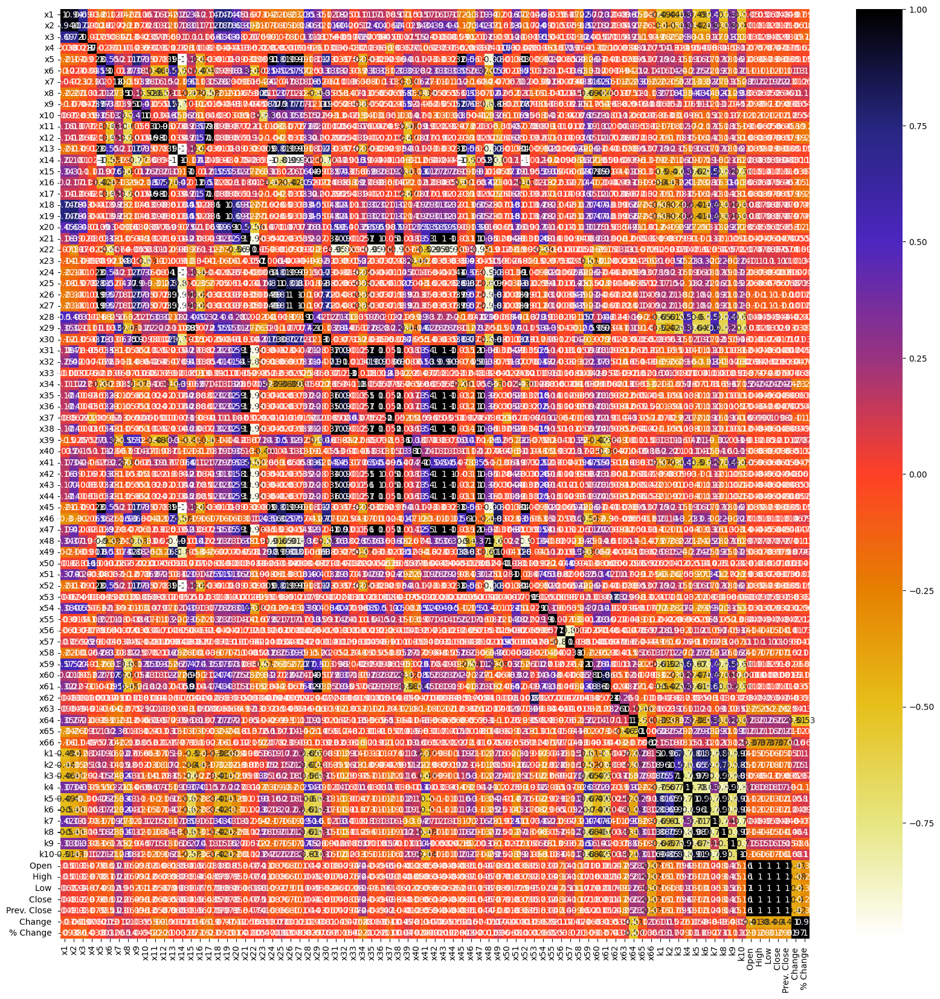

In [8]:
plt.figure(figsize=(20, 20))
cor = X.corr()
sns.heatmap(cor, annot=True, cmap=plt.cm.CMRmap_r)
plt.savefig('correlation.png')
plt.show()

In [9]:
def correlation(dataset, threshold):
    col_corr = set()  # Set of all the names of correlated columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold: # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.add(colname)
    return col_corr

corr_features = correlation(X, 0.97)
print(len(set(corr_features)))
print(corr_features)

29
{'x12', '% Change ', 'x38', 'x14', 'k10', 'x43', 'x24', 'x31', 'k9', 'x26', 'x36', 'k5', 'x17', 'x44', 'x19', 'x52', 'x47', 'Low ', 'x29', 'x49', 'Close ', 'x35', 'k8', 'x42', 'High ', 'x45', 'x27', 'x13', 'Prev. Close '}


In [10]:
try:
    X = X.drop(list(corr_features), axis=1)
except Exception as e:
    print(e)

In [11]:
from sklearn.preprocessing import MinMaxScaler
from pandas import DataFrame
trans = MinMaxScaler()
X = trans.fit_transform(X)
# # convert the array back to a dataframe
X = DataFrame(X)
# summarize
print(X.describe())

              0          1          2          3          4          5   \
count  94.000000  94.000000  94.000000  94.000000  94.000000  94.000000   
mean    0.171469   0.145874   0.060225   0.127195   0.035265   0.106216   
std     0.186500   0.206640   0.168501   0.102026   0.124327   0.195280   
min     0.000000   0.000000   0.000000   0.000000   0.000000   0.000000   
25%     0.071321   0.036608   0.001785   0.113147   0.006793   0.009942   
50%     0.114615   0.078849   0.008249   0.113778   0.010328   0.036407   
75%     0.179680   0.132666   0.025845   0.115642   0.016885   0.086194   
max     1.000000   1.000000   1.000000   1.000000   1.000000   1.000000   

              6          7          8          9   ...         44         45  \
count  94.000000  94.000000  94.000000  94.000000  ...  94.000000  94.000000   
mean    0.220364   0.097243   0.050920   0.579868  ...   0.652932   0.796751   
std     0.221315   0.196373   0.107153   0.111306  ...   0.327494   0.248161   
min 

In [12]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,  random_state = 100)

In [13]:
# Convert the data into DMatrix format, which is XGBoost's internal data structure
dtrain = xgb.DMatrix(X_train, label=y_train)
dtest = xgb.DMatrix(X_test, label=y_test)

# Set XGBoost parameters
params = {
    'objective': 'multi:softmax',  # Multiclass classification
    'num_class': 2,  # Number of classes in the target variable
    'max_depth': 3,
    'eta': 0.1,
    'subsample': 0.8,
    'colsample_bytree': 0.8,
    'eval_metric': 'mlogloss'  # Multiclass logloss
}
num_rounds = 50
model = xgb.train(params, dtrain, num_rounds)

# Make predictions on the test set
y_pred = model.predict(dtest)

# Convert predicted labels to integers
y_pred = np.round(y_pred).astype(int)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

Accuracy: 1.0


In [14]:
from mealpy import FloatVar
def fitness_function(position):
    learningrate,max_depth,subsample,n_estimators = position
    max_depth,n_estimators=int(max_depth),int(n_estimators)
    
    print(learningrate,max_depth,subsample,n_estimators)
    clf=xgb.XGBClassifier(eta=learningrate,n_estimators=n_estimators,max_depth=max_depth,subsample=subsample)
    evaluation= [(X_train, y_train ),(X_test,y_test)]
    clf.fit(X_train, y_train, eval_set=evaluation)
    # Accessing the evaluation results
    # Make predictions on the test set
    y_pred = clf.predict(X_test)
    
    # Convert predicted labels to integers
    y_pred = np.round(y_pred).astype(int)
    
    # Calculate accuracy
    accuracy = accuracy_score(y_test, y_pred)
    # evals_result = clf.evals_result()
    # val_accuracy = evals_result['validation_0']['auc'][-1]

    return accuracy
    
    # history = clf.fit(X_train,y_train, eval_set=evaluation,eval_metric='auc' )
    # return history.history['val_accuracy'][-1]


In [15]:
#!/usr/bin/env python
# Created by "Thieu" at 14:53, 17/03/2020 ----------%
#       Email: nguyenthieu2102@gmail.com            %
#       Github: https://github.com/thieu1995        %
# --------------------------------------------------%

import numpy as np
from mealpy.optimizer import Optimizer
from math import gamma


class LFGOASSA(Optimizer):
    """
    The original version of: Grasshopper Optimization Algorithm (GOA)

    Links:
        1. https://dx.doi.org/10.1016/j.advengsoft.2017.01.004
        2. https://www.mathworks.com/matlabcentral/fileexchange/61421-grasshopper-optimisation-algorithm-goa

    Hyper-parameters should fine-tune in approximate range to get faster convergence toward the global optimum:
        + c_min (float): coefficient c min, default = 0.00004
        + c_max (float): coefficient c max, default = 2.0

    Examples
    ~~~~~~~~
    >>> import numpy as np
    >>> from mealpy import FloatVar, GOA
    >>>
    >>> def objective_function(solution):
    >>>     return np.sum(solution**2)
    >>>
    >>> problem_dict = {
    >>>     "bounds": FloatVar(n_vars=30, lb=(-10.,) * 30, ub=(10.,) * 30, name="delta"),
    >>>     "minmax": "min",
    >>>     "obj_func": objective_function
    >>> }
    >>>
    >>> model = GOA.OriginalGOA(epoch=1000, pop_size=50, c_min = 0.00004, c_max = 1.0)
    >>> g_best = model.solve(problem_dict)
    >>> print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}")
    >>> print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}")

    References
    ~~~~~~~~~~
    [1] Saremi, S., Mirjalili, S. and Lewis, A., 2017. Grasshopper optimisation algorithm:
    theory and application. Advances in Engineering Software, 105, pp.30-47.
    """

    def __init__(self, epoch: int = 10000, pop_size: int = 100, c_min: float = 0.00004,n=2, c_max: float = 2.0, ST: float = 0.8, PD: float = 0.2, SD: float = 0.1,**kwargs: object) -> None:
        """
        Args:
            epoch (int): maximum number of iterations, default = 10000
            pop_size (int): number of population size, default = 100
            c_min (float): coefficient c min, default=0.00004
            c_max (float): coefficient c max, default=2.0
        """
        super().__init__(**kwargs)
        self.epoch = self.validator.check_int("epoch", epoch, [1, 100000])
        self.pop_size = self.validator.check_int("pop_size", pop_size, [5, 10000])
        self.c_min = self.validator.check_float("c_min", c_min, [0.00001, 0.2])
        self.c_max = self.validator.check_float("c_max", c_max, [0.2, 5.0])
        self.set_parameters(["epoch", "pop_size", "c_min", "c_max"])
        self.sort_flag = False
        self.beta=1.5
        self.ST = self.validator.check_float("ST", ST, (0, 1.0))
        self.PD = self.validator.check_float("PD", PD, (0, 1.0))
        self.SD = self.validator.check_float("SD", SD, (0, 1.0))
        self.set_parameters(["epoch", "pop_size", "ST", "PD", "SD"])
        self.n1 = int(self.PD * self.pop_size)
        self.n2 = int(self.SD * self.pop_size)
        self.n= n
        self.sort_flag = True

    def s_function__(self, r_vector=None):
        f = 0.5
        l = 1.5
        # Eq.(2.3) in the paper
        return f * np.exp(-r_vector / l) - np.exp(-r_vector)

    def evolve(self, epoch):
        """
        The main operations (equations) of algorithm. Inherit from Optimizer class

        Args:
            epoch (int): The current iteration
        """
        # Eq.(2.8) in the paper
        c = self.c_max - epoch * ((self.c_max - self.c_min) / self.epoch)
        
        pop_new = []
        num = gamma(1+self.beta)*np.sin(np.pi*self.beta/2)
        den = gamma((1+self.beta)/2)*self.beta*(2**((self.beta-1)/2))
        σu = (num/den)**(1/self.beta)
        σv = 1
        u = np.random.normal(0, σu, self.problem.n_dims)
        v = np.random.normal(0, σv, self.problem.n_dims)
        levy = u/(np.abs(v)**(1/self.beta))
        r2 = self.generator.uniform() 
        for idx in range(0, self.pop_size):
            if np.random.rand()<0.5:
                
                S_i_total = np.zeros(self.problem.n_dims)
                for j in range(0, self.pop_size):
                    dist = np.sqrt(np.sum((self.pop[idx].solution - self.pop[j].solution) ** 2))
                    r_ij_vector = (self.pop[idx].solution - self.pop[j].solution) / (dist + self.EPSILON)  # xj - xi / dij in Eq.(2.7)
                    xj_xi = 2 + np.remainder(dist, 2)  # |xjd - xid| in Eq. (2.7)
                    ## The first part inside the big bracket in Eq. (2.7)   16 955 230 764    212 047 193 643
                    ran = (c / 2) * (self.problem.ub - self.problem.lb)
                    s_ij = ran * self.s_function__(xj_xi) * r_ij_vector
                    S_i_total += s_ij
                x_new = (levy* c) * self.generator.normal(0, 1, self.problem.n_dims) * S_i_total + self.g_best.solution  # Eq. (2.7) in the paper g_best- T_d
            else:
                # Using equation (3) update the sparrow’s location;
                if idx < self.n1:
                    if r2 < self.ST:
                        des = (idx + 1) / (self.generator.uniform() * self.epoch + self.EPSILON)
                        if des > 5:
                            des = self.generator.uniform()
                        x_new = self.pop[idx].solution * np.exp(des)
                    else:
                        x_new = self.pop[idx].solution + self.generator.normal() * np.ones(self.problem.n_dims)
                else:
                    # Using equation (4) update the sparrow’s location;
                    _, x_p, worst = self.get_special_agents(self.pop, n_best=1, n_worst=1, minmax=self.problem.minmax)
                    g_best, g_worst = x_p[0], worst[0]
                    if idx > int(self.pop_size / 2):
                        x_new = self.generator.normal() * np.exp((g_worst.solution - self.pop[idx].solution) / (idx + 1) ** 2)
                    else:
                        L = np.ones((1, self.problem.n_dims))
                        A = np.sign(self.generator.uniform(-1, 1, (1, self.problem.n_dims)))
                        A1 = A.T * np.linalg.inv(np.matmul(A, A.T)) * L
                        x_new = g_best.solution + np.matmul(np.abs(self.pop[idx].solution - g_best.solution), A1)
                
            pos_new = self.correct_solution(x_new)
            agent = self.generate_empty_agent(pos_new)
            pop_new.append(agent)
            if self.mode not in self.AVAILABLE_MODES:
                agent.target = self.get_target(pos_new)
                self.pop[idx] = self.get_better_agent(agent, self.pop[idx], self.problem.minmax)
        if self.mode in self.AVAILABLE_MODES:
            pop_new = self.update_target_for_population(pop_new)
            self.pop = self.greedy_selection_population(self.pop, pop_new, self.problem.minmax)


from mealpy import FloatVar

# learningrate,max_depth,subsample,n_estimators
problem_dict = {
    "bounds": FloatVar( lb=(0.001,3,0, 50) , ub=(0.1, 18,1, 200) , name="delta"),
         "minmax": "max",
       "obj_func": fitness_function     }
model = LFGOASSA(epoch=50, pop_size=5)
g_best = model.solve(problem_dict)

with open('results_output.txt', 'a') as file:
    print(f"LFGOASSA MODEL:", file=file)
    print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}", file=file)
    print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}\n\n", file=file)

0.06450488249977084 6 0.8291000967677006 159
[0]	validation_0-logloss:0.63962	validation_1-logloss:0.64363
[1]	validation_0-logloss:0.59271	validation_1-logloss:0.59971
[2]	validation_0-logloss:0.54908	validation_1-logloss:0.55931
[3]	validation_0-logloss:0.50988	validation_1-logloss:0.52325
[4]	validation_0-logloss:0.47457	validation_1-logloss:0.49099
[5]	validation_0-logloss:0.44392	validation_1-logloss:0.45776
[6]	validation_0-logloss:0.41639	validation_1-logloss:0.42769
[7]	validation_0-logloss:0.39114	validation_1-logloss:0.40009
[8]	validation_0-logloss:0.36739	validation_1-logloss:0.37356
[9]	validation_0-logloss:0.34654	validation_1-logloss:0.35136
[10]	validation_0-logloss:0.32575	validation_1-logloss:0.33344
[11]	validation_0-logloss:0.30607	validation_1-logloss:0.31625
[12]	validation_0-logloss:0.28837	validation_1-logloss:0.30127
[13]	validation_0-logloss:0.27186	validation_1-logloss:0.28707
[14]	validation_0-logloss:0.25640	validation_1-logloss:0.27395
[15]	validation_0-lo

In [16]:
#!/usr/bin/env python
# Created by "Thieu" at 14:53, 17/03/2020 ----------%
#       Email: nguyenthieu2102@gmail.com            %
#       Github: https://github.com/thieu1995        %
# --------------------------------------------------%

import numpy as np
from mealpy.optimizer import Optimizer
from math import gamma

class GFLFGOA(Optimizer):
    """
    The original version of: Grasshopper Optimization Algorithm (GOA)

    Links:
        1. https://dx.doi.org/10.1016/j.advengsoft.2017.01.004
        2. https://www.mathworks.com/matlabcentral/fileexchange/61421-grasshopper-optimisation-algorithm-goa

    Hyper-parameters should fine-tune in approximate range to get faster convergence toward the global optimum:
        + c_min (float): coefficient c min, default = 0.00004
        + c_max (float): coefficient c max, default = 2.0

    Examples
    ~~~~~~~~
    >>> import numpy as np
    >>> from mealpy import FloatVar, GOA
    >>>
    >>> def objective_function(solution):
    >>>     return np.sum(solution**2)
    >>>
    >>> problem_dict = {
    >>>     "bounds": FloatVar(n_vars=30, lb=(-10.,) * 30, ub=(10.,) * 30, name="delta"),
    >>>     "minmax": "min",
    >>>     "obj_func": objective_function
    >>> }
    >>>
    >>> model = GOA.OriginalGOA(epoch=1000, pop_size=50, c_min = 0.00004, c_max = 1.0)
    >>> g_best = model.solve(problem_dict)
    >>> print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}")
    >>> print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}")

    References
    ~~~~~~~~~~
    [1] Saremi, S., Mirjalili, S. and Lewis, A., 2017. Grasshopper optimisation algorithm:
    theory and application. Advances in Engineering Software, 105, pp.30-47.
    """

    def __init__(self, epoch: int = 10000, pop_size: int = 100, c_min: float = 0.00004, c_max: float = 2.0, **kwargs: object) -> None:
        """
        Args:
            epoch (int): maximum number of iterations, default = 10000
            pop_size (int): number of population size, default = 100
            c_min (float): coefficient c min, default=0.00004
            c_max (float): coefficient c max, default=2.0
        """
        super().__init__(**kwargs)
        self.epoch = self.validator.check_int("epoch", epoch, [1, 100000])
        self.pop_size = self.validator.check_int("pop_size", pop_size, [5, 10000])
        self.c_min = self.validator.check_float("c_min", c_min, [0.00001, 0.2])
        self.c_max = self.validator.check_float("c_max", c_max, [0.2, 5.0])
        self.set_parameters(["epoch", "pop_size", "c_min", "c_max"])
        self.sort_flag = False
        self.beta=1.5

    def s_function__(self, r_vector=None):
        f = 0.5
        l = 1.5
        # Eq.(2.3) in the paper
        return f * np.exp(-r_vector / l) - np.exp(-r_vector)

    def evolve(self, epoch):
        """
        The main operations (equations) of algorithm. Inherit from Optimizer class

        Args:
            epoch (int): The current iteration
        """
        # Eq.(2.8) in the paper
        c = self.c_max - epoch * ((self.c_max - self.c_min) / self.epoch)
        pop_new = []
        num = gamma(1+self.beta)*np.sin(np.pi*self.beta/2)
        den = gamma((1+self.beta)/2)*self.beta*(2**((self.beta-1)/2))
        σu = (num/den)**(1/self.beta)
        σv = 1
        u = np.random.normal(0, σu, self.problem.n_dims)
        v = np.random.normal(0, σv, self.problem.n_dims)
        levy = u/(np.abs(v)**(1/self.beta))
        g=0.9
        r2 = self.generator.uniform()
        for idx in range(0, self.pop_size):
            S_i_total = np.zeros(self.problem.n_dims)
            for j in range(0, self.pop_size):
                dist = np.sqrt(np.sum((self.pop[idx].solution - self.pop[j].solution) ** 2))
                r_ij_vector = (self.pop[idx].solution - self.pop[j].solution) / (dist + self.EPSILON)  # xj - xi / dij in Eq.(2.7)
                xj_xi = 2 + np.remainder(dist, 2)  # |xjd - xid| in Eq. (2.7)
                ## The first part inside the big bracket in Eq. (2.7)   16 955 230 764    212 047 193 643
                ran = (c / 2) * (self.problem.ub - self.problem.lb)
                s_ij = ran * self.s_function__(xj_xi) * r_ij_vector
                G= g*r_ij_vector
                S_i_total = S_i_total+s_ij-G
            x_new = (levy* c) * self.generator.normal(0, 1, self.problem.n_dims) * S_i_total + self.g_best.solution  # Eq. (2.7) in the paper g_best- T_d
            pos_new = self.correct_solution(x_new)
            agent = self.generate_empty_agent(pos_new)
            pop_new.append(agent)
            if self.mode not in self.AVAILABLE_MODES:
                agent.target = self.get_target(pos_new)
                self.pop[idx] = self.get_better_agent(agent, self.pop[idx], self.problem.minmax)
        if self.mode in self.AVAILABLE_MODES:
            pop_new = self.update_target_for_population(pop_new)
            self.pop = self.greedy_selection_population(self.pop, pop_new, self.problem.minmax)


from mealpy import FloatVar

# learningrate,max_depth,subsample,n_estimators
problem_dict = {
    "bounds": FloatVar( lb=(0.001,3,0, 50) , ub=(0.1, 18,1, 200) , name="delta"),
         "minmax": "max",
       "obj_func": fitness_function     }
model = GFLFGOA(epoch=50, pop_size=5)
g_best = model.solve(problem_dict)

with open('results_output.txt', 'a') as file:
    print(f"GFLFGOA MODEL: ",file=file)
    print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}", file=file)
    print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}\n\n", file=file)

0.07875093241821242 5 0.9295302556682972 84
[0]	validation_0-logloss:0.62958	validation_1-logloss:0.63328
[1]	validation_0-logloss:0.57312	validation_1-logloss:0.58040
[2]	validation_0-logloss:0.52222	validation_1-logloss:0.53338
[3]	validation_0-logloss:0.47856	validation_1-logloss:0.49401
[4]	validation_0-logloss:0.43883	validation_1-logloss:0.45797
[5]	validation_0-logloss:0.40479	validation_1-logloss:0.42075
[6]	validation_0-logloss:0.37375	validation_1-logloss:0.39366
[7]	validation_0-logloss:0.34638	validation_1-logloss:0.36331
[8]	validation_0-logloss:0.32129	validation_1-logloss:0.33495
[9]	validation_0-logloss:0.29902	validation_1-logloss:0.31042
[10]	validation_0-logloss:0.27806	validation_1-logloss:0.29278
[11]	validation_0-logloss:0.25926	validation_1-logloss:0.27374
[12]	validation_0-logloss:0.24173	validation_1-logloss:0.26051
[13]	validation_0-logloss:0.22606	validation_1-logloss:0.24252
[14]	validation_0-logloss:0.21089	validation_1-logloss:0.22989
[15]	validation_0-log

In [17]:
#!/usr/bin/env python
# Created by "Thieu" at 14:53, 17/03/2020 ----------%
#       Email: nguyenthieu2102@gmail.com            %
#       Github: https://github.com/thieu1995        %
# --------------------------------------------------%

import numpy as np
from mealpy.optimizer import Optimizer
from math import gamma


class GFLFGOASSA(Optimizer):
    """
    The original version of: Grasshopper Optimization Algorithm (GOA)

    Links:
        1. https://dx.doi.org/10.1016/j.advengsoft.2017.01.004
        2. https://www.mathworks.com/matlabcentral/fileexchange/61421-grasshopper-optimisation-algorithm-goa

    Hyper-parameters should fine-tune in approximate range to get faster convergence toward the global optimum:
        + c_min (float): coefficient c min, default = 0.00004
        + c_max (float): coefficient c max, default = 2.0

    Examples
    ~~~~~~~~
    >>> import numpy as np
    >>> from mealpy import FloatVar, GOA
    >>>
    >>> def objective_function(solution):
    >>>     return np.sum(solution**2)
    >>>
    >>> problem_dict = {
    >>>     "bounds": FloatVar(n_vars=30, lb=(-10.,) * 30, ub=(10.,) * 30, name="delta"),
    >>>     "minmax": "min",
    >>>     "obj_func": objective_function
    >>> }
    >>>
    >>> model = GOA.OriginalGOA(epoch=1000, pop_size=50, c_min = 0.00004, c_max = 1.0)
    >>> g_best = model.solve(problem_dict)
    >>> print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}")
    >>> print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}")

    References
    ~~~~~~~~~~
    [1] Saremi, S., Mirjalili, S. and Lewis, A., 2017. Grasshopper optimisation algorithm:
    theory and application. Advances in Engineering Software, 105, pp.30-47.
    """

    def __init__(self, epoch: int = 10000, pop_size: int = 100, c_min: float = 0.00004,n=2, c_max: float = 2.0, ST: float = 0.8, PD: float = 0.2, SD: float = 0.1,**kwargs: object) -> None:
        """
        Args:
            epoch (int): maximum number of iterations, default = 10000
            pop_size (int): number of population size, default = 100
            c_min (float): coefficient c min, default=0.00004
            c_max (float): coefficient c max, default=2.0
        """
        super().__init__(**kwargs)
        self.epoch = self.validator.check_int("epoch", epoch, [1, 100000])
        self.pop_size = self.validator.check_int("pop_size", pop_size, [5, 10000])
        self.c_min = self.validator.check_float("c_min", c_min, [0.00001, 0.2])
        self.c_max = self.validator.check_float("c_max", c_max, [0.2, 5.0])
        self.set_parameters(["epoch", "pop_size", "c_min", "c_max"])
        self.sort_flag = False
        self.beta=1.5
        self.ST = self.validator.check_float("ST", ST, (0, 1.0))
        self.PD = self.validator.check_float("PD", PD, (0, 1.0))
        self.SD = self.validator.check_float("SD", SD, (0, 1.0))
        self.set_parameters(["epoch", "pop_size", "ST", "PD", "SD"])
        self.n1 = int(self.PD * self.pop_size)
        self.n2 = int(self.SD * self.pop_size)
        self.n= n
        self.sort_flag = True

    def s_function__(self, r_vector=None):
        f = 0.5
        l = 1.5
        # Eq.(2.3) in the paper
        return f * np.exp(-r_vector / l) - np.exp(-r_vector)

    def evolve(self, epoch):
        """
        The main operations (equations) of algorithm. Inherit from Optimizer class

        Args:
            epoch (int): The current iteration
        """
        # Eq.(2.8) in the paper
        c = self.c_max - epoch * ((self.c_max - self.c_min) / self.epoch)
        
        pop_new = []
        num = gamma(1+self.beta)*np.sin(np.pi*self.beta/2)
        den = gamma((1+self.beta)/2)*self.beta*(2**((self.beta-1)/2))
        σu = (num/den)**(1/self.beta)
        σv = 1
        u = np.random.normal(0, σu, self.problem.n_dims)
        v = np.random.normal(0, σv, self.problem.n_dims)
        levy = u/(np.abs(v)**(1/self.beta))
        g=0.9
        r2 = self.generator.uniform() 
        for idx in range(0, self.pop_size):
            if np.random.rand()<0.5:
                
                S_i_total = np.zeros(self.problem.n_dims)
                for j in range(0, self.pop_size):
                    dist = np.sqrt(np.sum((self.pop[idx].solution - self.pop[j].solution) ** 2))
                    r_ij_vector = (self.pop[idx].solution - self.pop[j].solution) / (dist + self.EPSILON)  # xj - xi / dij in Eq.(2.7)
                    xj_xi = 2 + np.remainder(dist, 2)  # |xjd - xid| in Eq. (2.7)
                    ## The first part inside the big bracket in Eq. (2.7)   16 955 230 764    212 047 193 643
                    ran = (c / 2) * (self.problem.ub - self.problem.lb)
                    s_ij = ran * self.s_function__(xj_xi) * r_ij_vector
                    G= g*r_ij_vector
                    S_i_total = S_i_total+s_ij-G
                x_new = (levy* c) * self.generator.normal(0, 1, self.problem.n_dims) * S_i_total + self.g_best.solution  # Eq. (2.7) in the paper g_best- T_d
            else:
                # Using equation (3) update the sparrow’s location;
                if idx < self.n1:
                    if r2 < self.ST:
                        des = (idx + 1) / (self.generator.uniform() * self.epoch + self.EPSILON)
                        if des > 5:
                            des = self.generator.uniform()
                        x_new = self.pop[idx].solution * np.exp(des)
                    else:
                        x_new = self.pop[idx].solution + self.generator.normal() * np.ones(self.problem.n_dims)
                else:
                    # Using equation (4) update the sparrow’s location;
                    _, x_p, worst = self.get_special_agents(self.pop, n_best=1, n_worst=1, minmax=self.problem.minmax)
                    g_best, g_worst = x_p[0], worst[0]
                    if idx > int(self.pop_size / 2):
                        x_new = self.generator.normal() * np.exp((g_worst.solution - self.pop[idx].solution) / (idx + 1) ** 2)
                    else:
                        L = np.ones((1, self.problem.n_dims))
                        A = np.sign(self.generator.uniform(-1, 1, (1, self.problem.n_dims)))
                        A1 = A.T * np.linalg.inv(np.matmul(A, A.T)) * L
                        x_new = g_best.solution + np.matmul(np.abs(self.pop[idx].solution - g_best.solution), A1)
                
            pos_new = self.correct_solution(x_new)
            agent = self.generate_empty_agent(pos_new)
            pop_new.append(agent)
            if self.mode not in self.AVAILABLE_MODES:
                agent.target = self.get_target(pos_new)
                self.pop[idx] = self.get_better_agent(agent, self.pop[idx], self.problem.minmax)
        if self.mode in self.AVAILABLE_MODES:
            pop_new = self.update_target_for_population(pop_new)
            self.pop = self.greedy_selection_population(self.pop, pop_new, self.problem.minmax)


from mealpy import FloatVar

# learningrate,max_depth,subsample,n_estimators
problem_dict = {
    "bounds": FloatVar( lb=(0.001,3,0, 50) , ub=(0.1, 18,1, 200) , name="delta"),
         "minmax": "max",
       "obj_func": fitness_function     }
model = GFLFGOASSA(epoch=50, pop_size=5)
g_best = model.solve(problem_dict)
with open('results_output.txt', 'a') as file:
    print(f"GFLFGOASSA MODEL:", file=file)
    print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}", file=file)
    print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}\n\n", file=file)

0.06732013789977982 6 0.2802813140194168 184
[0]	validation_0-logloss:0.65267	validation_1-logloss:0.66510
[1]	validation_0-logloss:0.61155	validation_1-logloss:0.61924
[2]	validation_0-logloss:0.57040	validation_1-logloss:0.58034
[3]	validation_0-logloss:0.54390	validation_1-logloss:0.55628
[4]	validation_0-logloss:0.51230	validation_1-logloss:0.52737
[5]	validation_0-logloss:0.48754	validation_1-logloss:0.50410
[6]	validation_0-logloss:0.45749	validation_1-logloss:0.47559
[7]	validation_0-logloss:0.43075	validation_1-logloss:0.44585
[8]	validation_0-logloss:0.41677	validation_1-logloss:0.43194
[9]	validation_0-logloss:0.39732	validation_1-logloss:0.41416
[10]	validation_0-logloss:0.37450	validation_1-logloss:0.39266
[11]	validation_0-logloss:0.36056	validation_1-logloss:0.37581
[12]	validation_0-logloss:0.34032	validation_1-logloss:0.35694
[13]	validation_0-logloss:0.32467	validation_1-logloss:0.33843
[14]	validation_0-logloss:0.31418	validation_1-logloss:0.33042
[15]	validation_0-lo

In [18]:
#!/usr/bin/env python
# Created by "Thieu" at 14:53, 17/03/2020 ----------%
#       Email: nguyenthieu2102@gmail.com            %
#       Github: https://github.com/thieu1995        %
# --------------------------------------------------%

import numpy as np
from mealpy.optimizer import Optimizer
from math import gamma


class GFGOASSA(Optimizer):
    """
    The original version of: Grasshopper Optimization Algorithm (GOA)

    Links:
        1. https://dx.doi.org/10.1016/j.advengsoft.2017.01.004
        2. https://www.mathworks.com/matlabcentral/fileexchange/61421-grasshopper-optimisation-algorithm-goa

    Hyper-parameters should fine-tune in approximate range to get faster convergence toward the global optimum:
        + c_min (float): coefficient c min, default = 0.00004
        + c_max (float): coefficient c max, default = 2.0

    Examples
    ~~~~~~~~
    >>> import numpy as np
    >>> from mealpy import FloatVar, GOA
    >>>
    >>> def objective_function(solution):
    >>>     return np.sum(solution**2)
    >>>
    >>> problem_dict = {
    >>>     "bounds": FloatVar(n_vars=30, lb=(-10.,) * 30, ub=(10.,) * 30, name="delta"),
    >>>     "minmax": "min",
    >>>     "obj_func": objective_function
    >>> }
    >>>
    >>> model = GOA.OriginalGOA(epoch=1000, pop_size=50, c_min = 0.00004, c_max = 1.0)
    >>> g_best = model.solve(problem_dict)
    >>> print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}")
    >>> print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}")

    References
    ~~~~~~~~~~
    [1] Saremi, S., Mirjalili, S. and Lewis, A., 2017. Grasshopper optimisation algorithm:
    theory and application. Advances in Engineering Software, 105, pp.30-47.
    """

    def __init__(self, epoch: int = 10000, pop_size: int = 100, c_min: float = 0.00004,n=2, c_max: float = 2.0, ST: float = 0.8, PD: float = 0.2, SD: float = 0.1,**kwargs: object) -> None:
        """
        Args:
            epoch (int): maximum number of iterations, default = 10000
            pop_size (int): number of population size, default = 100
            c_min (float): coefficient c min, default=0.00004
            c_max (float): coefficient c max, default=2.0
        """
        super().__init__(**kwargs)
        self.epoch = self.validator.check_int("epoch", epoch, [1, 100000])
        self.pop_size = self.validator.check_int("pop_size", pop_size, [5, 10000])
        self.c_min = self.validator.check_float("c_min", c_min, [0.00001, 0.2])
        self.c_max = self.validator.check_float("c_max", c_max, [0.2, 5.0])
        self.set_parameters(["epoch", "pop_size", "c_min", "c_max"])
        self.sort_flag = False
        self.beta=1.5
        self.ST = self.validator.check_float("ST", ST, (0, 1.0))
        self.PD = self.validator.check_float("PD", PD, (0, 1.0))
        self.SD = self.validator.check_float("SD", SD, (0, 1.0))
        self.set_parameters(["epoch", "pop_size", "ST", "PD", "SD"])
        self.n1 = int(self.PD * self.pop_size)
        self.n2 = int(self.SD * self.pop_size)
        self.n= n
        self.sort_flag = True

    def s_function__(self, r_vector=None):
        f = 0.5
        l = 1.5
        # Eq.(2.3) in the paper
        return f * np.exp(-r_vector / l) - np.exp(-r_vector)

    def evolve(self, epoch):
        """
        The main operations (equations) of algorithm. Inherit from Optimizer class

        Args:
            epoch (int): The current iteration
        """
        # Eq.(2.8) in the paper
        c = self.c_max - epoch * ((self.c_max - self.c_min) / self.epoch)
        
        pop_new = []
        num = gamma(1+self.beta)*np.sin(np.pi*self.beta/2)
        den = gamma((1+self.beta)/2)*self.beta*(2**((self.beta-1)/2))
        σu = (num/den)**(1/self.beta)
        σv = 1
        u = np.random.normal(0, σu, self.problem.n_dims)
        v = np.random.normal(0, σv, self.problem.n_dims)
        levy = u/(np.abs(v)**(1/self.beta))
        g=0.9
        r2 = self.generator.uniform() 
        for idx in range(0, self.pop_size):
            if np.random.rand()<0.5:
                
                S_i_total = np.zeros(self.problem.n_dims)
                for j in range(0, self.pop_size):
                    dist = np.sqrt(np.sum((self.pop[idx].solution - self.pop[j].solution) ** 2))
                    r_ij_vector = (self.pop[idx].solution - self.pop[j].solution) / (dist + self.EPSILON)  # xj - xi / dij in Eq.(2.7)
                    xj_xi = 2 + np.remainder(dist, 2)  # |xjd - xid| in Eq. (2.7)
                    ## The first part inside the big bracket in Eq. (2.7)   16 955 230 764    212 047 193 643
                    ran = (c / 2) * (self.problem.ub - self.problem.lb)
                    s_ij = ran * self.s_function__(xj_xi) * r_ij_vector
                    G= g*r_ij_vector
                    S_i_total = S_i_total+s_ij-G
                x_new = ( c) * self.generator.normal(0, 1, self.problem.n_dims) * S_i_total + self.g_best.solution  # Eq. (2.7) in the paper g_best- T_d
            else:
                # Using equation (3) update the sparrow’s location;
                if idx < self.n1:
                    if r2 < self.ST:
                        des = (idx + 1) / (self.generator.uniform() * self.epoch + self.EPSILON)
                        if des > 5:
                            des = self.generator.uniform()
                        x_new = self.pop[idx].solution * np.exp(des)
                    else:
                        x_new = self.pop[idx].solution + self.generator.normal() * np.ones(self.problem.n_dims)
                else:
                    # Using equation (4) update the sparrow’s location;
                    _, x_p, worst = self.get_special_agents(self.pop, n_best=1, n_worst=1, minmax=self.problem.minmax)
                    g_best, g_worst = x_p[0], worst[0]
                    if idx > int(self.pop_size / 2):
                        x_new = self.generator.normal() * np.exp((g_worst.solution - self.pop[idx].solution) / (idx + 1) ** 2)
                    else:
                        L = np.ones((1, self.problem.n_dims))
                        A = np.sign(self.generator.uniform(-1, 1, (1, self.problem.n_dims)))
                        A1 = A.T * np.linalg.inv(np.matmul(A, A.T)) * L
                        x_new = g_best.solution + np.matmul(np.abs(self.pop[idx].solution - g_best.solution), A1)
                
            pos_new = self.correct_solution(x_new)
            agent = self.generate_empty_agent(pos_new)
            pop_new.append(agent)
            if self.mode not in self.AVAILABLE_MODES:
                agent.target = self.get_target(pos_new)
                self.pop[idx] = self.get_better_agent(agent, self.pop[idx], self.problem.minmax)
        if self.mode in self.AVAILABLE_MODES:
            pop_new = self.update_target_for_population(pop_new)
            self.pop = self.greedy_selection_population(self.pop, pop_new, self.problem.minmax)


from mealpy import FloatVar

# learningrate,max_depth,subsample,n_estimators
problem_dict = {
    "bounds": FloatVar( lb=(0.001,3,0, 50) , ub=(0.1, 18,1, 200) , name="delta"),
         "minmax": "max",
       "obj_func": fitness_function     }
model = GFGOASSA(epoch=50, pop_size=5)
g_best = model.solve(problem_dict)
with open('results_output.txt', 'a') as file:
    print(f"GFGOASSA MODEL:", file=file)
    print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}", file=file)
    print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}\n\n", file=file)

0.08337361751487209 15 0.3551346209856848 199
[0]	validation_0-logloss:0.64271	validation_1-logloss:0.65611
[1]	validation_0-logloss:0.59202	validation_1-logloss:0.59939
[2]	validation_0-logloss:0.54307	validation_1-logloss:0.55329
[3]	validation_0-logloss:0.51155	validation_1-logloss:0.51377
[4]	validation_0-logloss:0.47508	validation_1-logloss:0.48142
[5]	validation_0-logloss:0.44451	validation_1-logloss:0.45379
[6]	validation_0-logloss:0.41108	validation_1-logloss:0.42284
[7]	validation_0-logloss:0.38258	validation_1-logloss:0.39116
[8]	validation_0-logloss:0.36711	validation_1-logloss:0.37630
[9]	validation_0-logloss:0.34657	validation_1-logloss:0.35785
[10]	validation_0-logloss:0.32207	validation_1-logloss:0.33506
[11]	validation_0-logloss:0.30769	validation_1-logloss:0.31738
[12]	validation_0-logloss:0.28684	validation_1-logloss:0.29837
[13]	validation_0-logloss:0.27061	validation_1-logloss:0.27886
[14]	validation_0-logloss:0.25987	validation_1-logloss:0.27106
[15]	validation_0-l

In [19]:
df = pd.read_csv(r'/kaggle/input/final-dataset-for-embedding-combination/ConvE_30_with_fr.csv')
df

,Unnamed: 0,Folder_name,Feature_name,x1,x2,x3,x4,x5,x6,x7,...,k28,k29,k30,Open,High,Low,Close,Prev. Close,Change,% Change
0,0,ABG Shipyard Limited,2013,0.95,0.40,0.003346,2.27,0.707756,0.017817,18.88,...,0.949038,-0.936473,0.556204,19.204890,20.043685,18.323994,19.321036,19.295528,0.025458,0.265418
1,4,ANG Industries Limited,2013,1.14,0.51,0.060725,1.53,0.523116,0.138180,51.51,...,0.947105,-0.320443,0.173695,19.204890,20.043685,18.323994,19.321036,19.295528,0.025458,0.265418
2,5,ANG Industries Limited,2015,1.08,0.49,0.037860,1.72,0.562869,0.151222,51.31,...,-1.316149,0.682257,-0.050842,17.999170,18.787287,16.485577,18.010405,18.001943,0.008623,0.242227
3,6,ANG Industries Limited,2016,0.96,0.41,0.020800,1.77,0.601283,0.147791,58.66,...,-0.556534,0.379132,-0.448913,15.342440,15.849919,14.075262,15.325655,15.342440,-0.016573,-0.024677
4,7,ANG Industries Limited,2017,0.31,0.17,0.004391,-2.81,1.076724,0.164016,56.30,...,-0.455134,-0.264604,-1.311759,12.948232,13.488902,11.567490,12.961799,12.948232,0.013740,0.197033
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89,46,Jaypee Infratech Limited,2020,0.70,0.08,0.006177,-4.37,0.776451,0.127856,7.84,...,1.547528,-2.229153,1.748261,25.511968,26.398444,23.216697,25.516386,25.699317,-0.183574,-0.352289
90,47,Jaypee Infratech Limited,2021,0.63,0.08,0.014797,-1.72,0.877271,0.128827,3.30,...,1.500654,-2.640672,1.265699,17.841734,18.662440,16.379446,17.841391,17.841734,-0.000363,0.163992
91,41,Jenson & Nicholson (India) Limited,2016,0.03,0.02,0.006709,-0.23,23.069427,1.188889,240.19,...,1.821351,-1.398491,-0.492305,15.342440,15.849919,14.075262,15.325655,15.342440,-0.016573,-0.024677
92,42,Jenson & Nicholson (India) Limited,2017,0.01,0.01,0.002659,-0.22,34.559140,1.213938,74.81,...,0.893543,-0.050286,1.010182,12.948232,13.488902,11.567490,12.961799,12.948232,0.013740,0.197033


In [20]:
list(df.columns)

['Unnamed: 0',
 'Folder_name',
 'Feature_name',
 'x1',
 'x2',
 'x3',
 'x4',
 'x5',
 'x6',
 'x7',
 'x8',
 'x9',
 'x10',
 'x11',
 'x12',
 'x13',
 'x14',
 'x15',
 'x16',
 'x17',
 'x18',
 'x19',
 'x20',
 'x21',
 'x22',
 'x23',
 'x24',
 'x25',
 'x26',
 'x27',
 'x28',
 'x29',
 'x30',
 'x31',
 'x32',
 'x33',
 'x34',
 'x35',
 'x36',
 'x37',
 'x38',
 'x39',
 'x40',
 'x41',
 'x42',
 'x43',
 'x44',
 'x45',
 'x46',
 'x47',
 'x48',
 'x49',
 'x50',
 'x51',
 'x52',
 'x53',
 'x54',
 'x55',
 'x56',
 'x57',
 'x58',
 'x59',
 'x60',
 'x61',
 'x62',
 'x63',
 'x64',
 'x65',
 'x66',
 'Label',
 'Bankruptcy',
 'path',
 'k1',
 'k2',
 'k3',
 'k4',
 'k5',
 'k6',
 'k7',
 'k8',
 'k9',
 'k10',
 'k11',
 'k12',
 'k13',
 'k14',
 'k15',
 'k16',
 'k17',
 'k18',
 'k19',
 'k20',
 'k21',
 'k22',
 'k23',
 'k24',
 'k25',
 'k26',
 'k27',
 'k28',
 'k29',
 'k30',
 'Open ',
 'High ',
 'Low ',
 'Close ',
 'Prev. Close ',
 'Change ',
 '% Change ']

In [21]:
drop_col = ['Unnamed: 0', 'Label', 'Bankruptcy', 'Folder_name', 'Feature_name', 'path']
df = df.sort_values(by=["Folder_name", "Feature_name"])
df.dropna(inplace=True)
X = df.drop(drop_col, axis=1)
y = df['Label']

In [22]:
print('original feature len', len(df.columns))
print('original features', (df.columns))
print(df.head())

original feature len 109
original features Index(['Unnamed: 0', 'Folder_name', 'Feature_name', 'x1', 'x2', 'x3', 'x4',
       'x5', 'x6', 'x7',
       ...
       'k28', 'k29', 'k30', 'Open ', 'High ', 'Low ', 'Close ', 'Prev. Close ',
       'Change ', '% Change '],
      dtype='object', length=109)
   Unnamed: 0             Folder_name  Feature_name    x1    x2        x3  \
0           0    ABG Shipyard Limited          2013  0.95  0.40  0.003346   
1           4  ANG Industries Limited          2013  1.14  0.51  0.060725   
2           5  ANG Industries Limited          2015  1.08  0.49  0.037860   
3           6  ANG Industries Limited          2016  0.96  0.41  0.020800   
4           7  ANG Industries Limited          2017  0.31  0.17  0.004391   

     x4        x5        x6     x7  ...       k28       k29       k30  \
0  2.27  0.707756  0.017817  18.88  ...  0.949038 -0.936473  0.556204   
1  1.53  0.523116  0.138180  51.51  ...  0.947105 -0.320443  0.173695   
2  1.72  0.562869

In [23]:
numeric_only = df.describe().columns
df.describe()

,Unnamed: 0,Feature_name,x1,x2,x3,x4,x5,x6,x7,x8,...,k28,k29,k30,Open,High,Low,Close,Prev. Close,Change,% Change
count,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,...,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000,94.000000
mean,48.712766,2018.489362,1.722979,1.175532,0.272789,6.462128,1.223905,0.167203,52.929255,6.011116,...,0.024879,0.014614,-0.001589,17.111229,17.825825,15.610730,17.137938,17.138194,-0.000232,0.122708
std,28.812565,2.605803,1.863132,1.651056,0.763100,46.933882,4.295959,0.305868,53.157638,11.313087,...,1.026051,0.976393,1.022544,3.941243,4.094648,3.640952,3.955928,3.994483,0.095279,0.287046
min,0.000000,2012.000000,0.010000,0.010000,0.000045,-52.050000,0.005373,0.000836,0.000000,0.408903,...,-2.211658,-2.640672,-3.703657,12.444787,12.918303,11.567490,12.444370,12.444787,-0.183574,-0.352289
25%,24.250000,2017.000000,0.722500,0.302500,0.008128,0.000000,0.240103,0.016408,6.820000,1.035058,...,-0.727767,-0.548245,-0.633145,13.394924,13.924419,12.156342,13.407075,13.395811,-0.016573,-0.024677
50%,48.500000,2018.000000,1.155000,0.640000,0.037404,0.290000,0.362244,0.057861,43.840000,1.840619,...,0.083245,-0.049215,0.105467,16.359275,17.048378,14.857233,16.342896,16.359275,0.001996,0.132621
75%,72.750000,2020.000000,1.805000,1.070000,0.117092,1.147500,0.588824,0.135842,80.907500,4.454373,...,0.824515,0.658038,0.691784,19.232581,20.262817,17.555142,19.402197,19.241812,0.013740,0.197033
max,98.000000,2023.000000,10.000000,8.000000,4.528798,407.970000,34.559140,1.567138,240.190000,58.019097,...,1.821351,2.409225,2.058683,25.511968,26.398444,23.216697,25.516386,25.699317,0.187652,0.708502


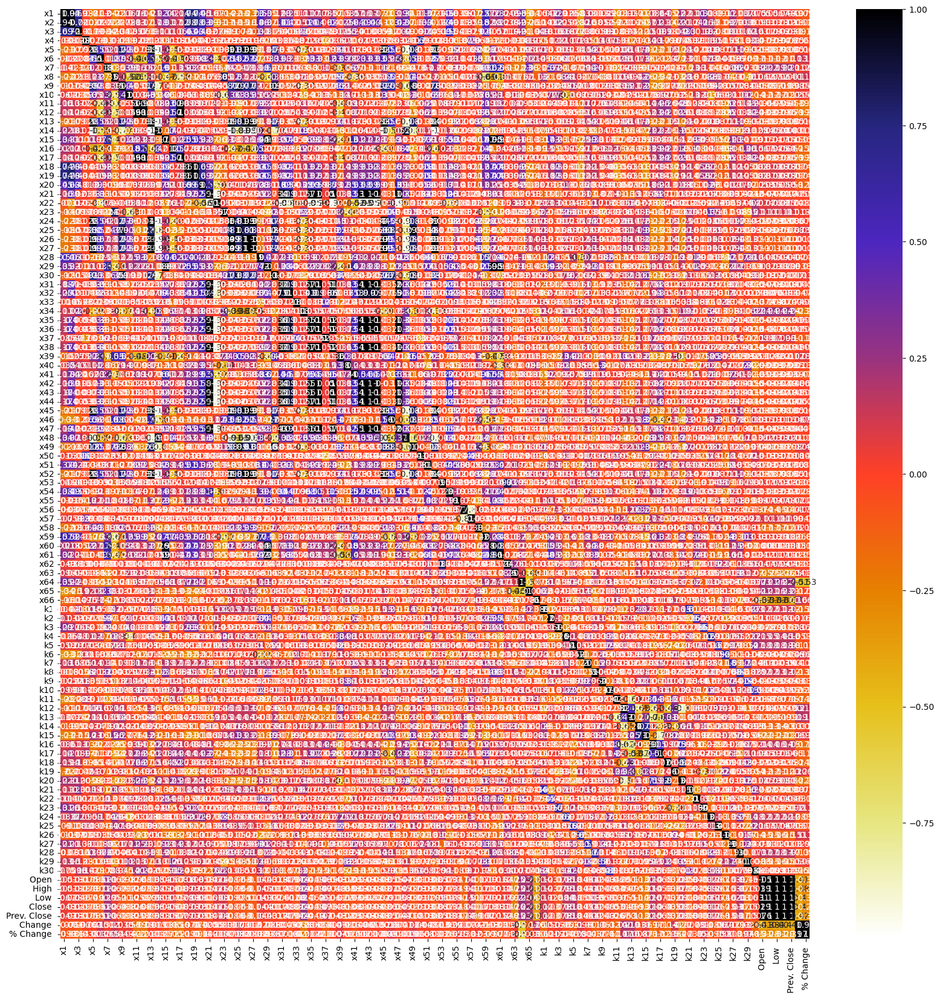

In [24]:
plt.figure(figsize=(20, 20))
cor = X.corr()
sns.heatmap(cor, annot=True, cmap=plt.cm.CMRmap_r)
plt.savefig('correlation_30.png')
plt.show()

In [25]:
def correlation(dataset, threshold):
    col_corr = set()  # Set of all the names of correlated columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold: # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.add(colname)
    return col_corr

corr_features = correlation(X, 0.97)
print(len(set(corr_features)))
print(corr_features)

25
{'x12', '% Change ', 'x38', 'x14', 'x43', 'x24', 'x31', 'x26', 'x36', 'x17', 'x44', 'x19', 'x52', 'x47', 'Low ', 'x29', 'x49', 'Close ', 'x35', 'x42', 'High ', 'x45', 'x27', 'x13', 'Prev. Close '}


In [26]:
try:
    X = X.drop(list(corr_features), axis=1)
except Exception as e:
    print(e)

In [27]:
from sklearn.preprocessing import MinMaxScaler
from pandas import DataFrame
trans = MinMaxScaler()
X = trans.fit_transform(X)
# # convert the array back to a dataframe
X = DataFrame(X)
# summarize
print(X.describe())

              0          1          2          3          4          5   \
count  94.000000  94.000000  94.000000  94.000000  94.000000  94.000000   
mean    0.171469   0.145874   0.060225   0.127195   0.035265   0.106216   
std     0.186500   0.206640   0.168501   0.102026   0.124327   0.195280   
min     0.000000   0.000000   0.000000   0.000000   0.000000   0.000000   
25%     0.071321   0.036608   0.001785   0.113147   0.006793   0.009942   
50%     0.114615   0.078849   0.008249   0.113778   0.010328   0.036407   
75%     0.179680   0.132666   0.025845   0.115642   0.016885   0.086194   
max     1.000000   1.000000   1.000000   1.000000   1.000000   1.000000   

              6          7          8          9   ...         68         69  \
count  94.000000  94.000000  94.000000  94.000000  ...  94.000000  94.000000   
mean    0.220364   0.097243   0.050920   0.579868  ...   0.539608   0.526310   
std     0.221315   0.196373   0.107153   0.111306  ...   0.190837   0.193665   
min 

In [28]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,  random_state = 100)

In [29]:
# Convert the data into DMatrix format, which is XGBoost's internal data structure
dtrain = xgb.DMatrix(X_train, label=y_train)
dtest = xgb.DMatrix(X_test, label=y_test)

# Set XGBoost parameters
params = {
    'objective': 'multi:softmax',  # Multiclass classification
    'num_class': 2,  # Number of classes in the target variable
    'max_depth': 3,
    'eta': 0.1,
    'subsample': 0.8,
    'colsample_bytree': 0.8,
    'eval_metric': 'mlogloss'  # Multiclass logloss
}
num_rounds = 50
model = xgb.train(params, dtrain, num_rounds)

# Make predictions on the test set
y_pred = model.predict(dtest)

# Convert predicted labels to integers
y_pred = np.round(y_pred).astype(int)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

Accuracy: 1.0


In [30]:
from mealpy import FloatVar
def fitness_function(position):
    learningrate,max_depth,subsample,n_estimators = position
    max_depth,n_estimators=int(max_depth),int(n_estimators)
    
    print(learningrate,max_depth,subsample,n_estimators)
    clf=xgb.XGBClassifier(eta=learningrate,n_estimators=n_estimators,max_depth=max_depth,subsample=subsample)
    evaluation= [(X_train, y_train ),(X_test,y_test)]
    clf.fit(X_train, y_train, eval_set=evaluation)
    # Accessing the evaluation results
    # Make predictions on the test set
    y_pred = clf.predict(X_test)
    
    # Convert predicted labels to integers
    y_pred = np.round(y_pred).astype(int)
    
    # Calculate accuracy
    accuracy = accuracy_score(y_test, y_pred)
    # evals_result = clf.evals_result()
    # val_accuracy = evals_result['validation_0']['auc'][-1]

    return accuracy
    
    # history = clf.fit(X_train,y_train, eval_set=evaluation,eval_metric='auc' )
    # return history.history['val_accuracy'][-1]


In [31]:
#!/usr/bin/env python
# Created by "Thieu" at 14:53, 17/03/2020 ----------%
#       Email: nguyenthieu2102@gmail.com            %
#       Github: https://github.com/thieu1995        %
# --------------------------------------------------%

import numpy as np
from mealpy.optimizer import Optimizer
from math import gamma


class LFGOASSA(Optimizer):
    """
    The original version of: Grasshopper Optimization Algorithm (GOA)

    Links:
        1. https://dx.doi.org/10.1016/j.advengsoft.2017.01.004
        2. https://www.mathworks.com/matlabcentral/fileexchange/61421-grasshopper-optimisation-algorithm-goa

    Hyper-parameters should fine-tune in approximate range to get faster convergence toward the global optimum:
        + c_min (float): coefficient c min, default = 0.00004
        + c_max (float): coefficient c max, default = 2.0

    Examples
    ~~~~~~~~
    >>> import numpy as np
    >>> from mealpy import FloatVar, GOA
    >>>
    >>> def objective_function(solution):
    >>>     return np.sum(solution**2)
    >>>
    >>> problem_dict = {
    >>>     "bounds": FloatVar(n_vars=30, lb=(-10.,) * 30, ub=(10.,) * 30, name="delta"),
    >>>     "minmax": "min",
    >>>     "obj_func": objective_function
    >>> }
    >>>
    >>> model = GOA.OriginalGOA(epoch=1000, pop_size=50, c_min = 0.00004, c_max = 1.0)
    >>> g_best = model.solve(problem_dict)
    >>> print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}")
    >>> print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}")

    References
    ~~~~~~~~~~
    [1] Saremi, S., Mirjalili, S. and Lewis, A., 2017. Grasshopper optimisation algorithm:
    theory and application. Advances in Engineering Software, 105, pp.30-47.
    """

    def __init__(self, epoch: int = 10000, pop_size: int = 100, c_min: float = 0.00004,n=2, c_max: float = 2.0, ST: float = 0.8, PD: float = 0.2, SD: float = 0.1,**kwargs: object) -> None:
        """
        Args:
            epoch (int): maximum number of iterations, default = 10000
            pop_size (int): number of population size, default = 100
            c_min (float): coefficient c min, default=0.00004
            c_max (float): coefficient c max, default=2.0
        """
        super().__init__(**kwargs)
        self.epoch = self.validator.check_int("epoch", epoch, [1, 100000])
        self.pop_size = self.validator.check_int("pop_size", pop_size, [5, 10000])
        self.c_min = self.validator.check_float("c_min", c_min, [0.00001, 0.2])
        self.c_max = self.validator.check_float("c_max", c_max, [0.2, 5.0])
        self.set_parameters(["epoch", "pop_size", "c_min", "c_max"])
        self.sort_flag = False
        self.beta=1.5
        self.ST = self.validator.check_float("ST", ST, (0, 1.0))
        self.PD = self.validator.check_float("PD", PD, (0, 1.0))
        self.SD = self.validator.check_float("SD", SD, (0, 1.0))
        self.set_parameters(["epoch", "pop_size", "ST", "PD", "SD"])
        self.n1 = int(self.PD * self.pop_size)
        self.n2 = int(self.SD * self.pop_size)
        self.n= n
        self.sort_flag = True

    def s_function__(self, r_vector=None):
        f = 0.5
        l = 1.5
        # Eq.(2.3) in the paper
        return f * np.exp(-r_vector / l) - np.exp(-r_vector)

    def evolve(self, epoch):
        """
        The main operations (equations) of algorithm. Inherit from Optimizer class

        Args:
            epoch (int): The current iteration
        """
        # Eq.(2.8) in the paper
        c = self.c_max - epoch * ((self.c_max - self.c_min) / self.epoch)
        
        pop_new = []
        num = gamma(1+self.beta)*np.sin(np.pi*self.beta/2)
        den = gamma((1+self.beta)/2)*self.beta*(2**((self.beta-1)/2))
        σu = (num/den)**(1/self.beta)
        σv = 1
        u = np.random.normal(0, σu, self.problem.n_dims)
        v = np.random.normal(0, σv, self.problem.n_dims)
        levy = u/(np.abs(v)**(1/self.beta))
        r2 = self.generator.uniform() 
        for idx in range(0, self.pop_size):
            if np.random.rand()<0.5:
                
                S_i_total = np.zeros(self.problem.n_dims)
                for j in range(0, self.pop_size):
                    dist = np.sqrt(np.sum((self.pop[idx].solution - self.pop[j].solution) ** 2))
                    r_ij_vector = (self.pop[idx].solution - self.pop[j].solution) / (dist + self.EPSILON)  # xj - xi / dij in Eq.(2.7)
                    xj_xi = 2 + np.remainder(dist, 2)  # |xjd - xid| in Eq. (2.7)
                    ## The first part inside the big bracket in Eq. (2.7)   16 955 230 764    212 047 193 643
                    ran = (c / 2) * (self.problem.ub - self.problem.lb)
                    s_ij = ran * self.s_function__(xj_xi) * r_ij_vector
                    S_i_total += s_ij
                x_new = (levy* c) * self.generator.normal(0, 1, self.problem.n_dims) * S_i_total + self.g_best.solution  # Eq. (2.7) in the paper g_best- T_d
            else:
                # Using equation (3) update the sparrow’s location;
                if idx < self.n1:
                    if r2 < self.ST:
                        des = (idx + 1) / (self.generator.uniform() * self.epoch + self.EPSILON)
                        if des > 5:
                            des = self.generator.uniform()
                        x_new = self.pop[idx].solution * np.exp(des)
                    else:
                        x_new = self.pop[idx].solution + self.generator.normal() * np.ones(self.problem.n_dims)
                else:
                    # Using equation (4) update the sparrow’s location;
                    _, x_p, worst = self.get_special_agents(self.pop, n_best=1, n_worst=1, minmax=self.problem.minmax)
                    g_best, g_worst = x_p[0], worst[0]
                    if idx > int(self.pop_size / 2):
                        x_new = self.generator.normal() * np.exp((g_worst.solution - self.pop[idx].solution) / (idx + 1) ** 2)
                    else:
                        L = np.ones((1, self.problem.n_dims))
                        A = np.sign(self.generator.uniform(-1, 1, (1, self.problem.n_dims)))
                        A1 = A.T * np.linalg.inv(np.matmul(A, A.T)) * L
                        x_new = g_best.solution + np.matmul(np.abs(self.pop[idx].solution - g_best.solution), A1)
                
            pos_new = self.correct_solution(x_new)
            agent = self.generate_empty_agent(pos_new)
            pop_new.append(agent)
            if self.mode not in self.AVAILABLE_MODES:
                agent.target = self.get_target(pos_new)
                self.pop[idx] = self.get_better_agent(agent, self.pop[idx], self.problem.minmax)
        if self.mode in self.AVAILABLE_MODES:
            pop_new = self.update_target_for_population(pop_new)
            self.pop = self.greedy_selection_population(self.pop, pop_new, self.problem.minmax)


from mealpy import FloatVar

# learningrate,max_depth,subsample,n_estimators
problem_dict = {
    "bounds": FloatVar( lb=(0.001,3,0, 50) , ub=(0.1, 18,1, 200) , name="delta"),
         "minmax": "max",
       "obj_func": fitness_function     }
model = LFGOASSA(epoch=50, pop_size=5)
g_best = model.solve(problem_dict)
with open('results_output.txt', 'a') as file:
    print(f"LFGOASSA MODEL:", file=file)
    print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}", file=file)
    print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}\n\n", file=file)

0.009731719298821374 13 0.6772105319779598 92
[0]	validation_0-logloss:0.68433	validation_1-logloss:0.69166
[1]	validation_0-logloss:0.67662	validation_1-logloss:0.68341
[2]	validation_0-logloss:0.66959	validation_1-logloss:0.67729
[3]	validation_0-logloss:0.66194	validation_1-logloss:0.66911
[4]	validation_0-logloss:0.65594	validation_1-logloss:0.66368
[5]	validation_0-logloss:0.64947	validation_1-logloss:0.65775
[6]	validation_0-logloss:0.64255	validation_1-logloss:0.65036
[7]	validation_0-logloss:0.63559	validation_1-logloss:0.64288
[8]	validation_0-logloss:0.62918	validation_1-logloss:0.63710
[9]	validation_0-logloss:0.62282	validation_1-logloss:0.63079
[10]	validation_0-logloss:0.61680	validation_1-logloss:0.62451
[11]	validation_0-logloss:0.61049	validation_1-logloss:0.61825
[12]	validation_0-logloss:0.60446	validation_1-logloss:0.61181
[13]	validation_0-logloss:0.59818	validation_1-logloss:0.60509
[14]	validation_0-logloss:0.59204	validation_1-logloss:0.59924
[15]	validation_0-l

In [32]:
#!/usr/bin/env python
# Created by "Thieu" at 14:53, 17/03/2020 ----------%
#       Email: nguyenthieu2102@gmail.com            %
#       Github: https://github.com/thieu1995        %
# --------------------------------------------------%

import numpy as np
from mealpy.optimizer import Optimizer
from math import gamma

class GFLFGOA(Optimizer):
    """
    The original version of: Grasshopper Optimization Algorithm (GOA)

    Links:
        1. https://dx.doi.org/10.1016/j.advengsoft.2017.01.004
        2. https://www.mathworks.com/matlabcentral/fileexchange/61421-grasshopper-optimisation-algorithm-goa

    Hyper-parameters should fine-tune in approximate range to get faster convergence toward the global optimum:
        + c_min (float): coefficient c min, default = 0.00004
        + c_max (float): coefficient c max, default = 2.0

    Examples
    ~~~~~~~~
    >>> import numpy as np
    >>> from mealpy import FloatVar, GOA
    >>>
    >>> def objective_function(solution):
    >>>     return np.sum(solution**2)
    >>>
    >>> problem_dict = {
    >>>     "bounds": FloatVar(n_vars=30, lb=(-10.,) * 30, ub=(10.,) * 30, name="delta"),
    >>>     "minmax": "min",
    >>>     "obj_func": objective_function
    >>> }
    >>>
    >>> model = GOA.OriginalGOA(epoch=1000, pop_size=50, c_min = 0.00004, c_max = 1.0)
    >>> g_best = model.solve(problem_dict)
    >>> print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}")
    >>> print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}")

    References
    ~~~~~~~~~~
    [1] Saremi, S., Mirjalili, S. and Lewis, A., 2017. Grasshopper optimisation algorithm:
    theory and application. Advances in Engineering Software, 105, pp.30-47.
    """

    def __init__(self, epoch: int = 10000, pop_size: int = 100, c_min: float = 0.00004, c_max: float = 2.0, **kwargs: object) -> None:
        """
        Args:
            epoch (int): maximum number of iterations, default = 10000
            pop_size (int): number of population size, default = 100
            c_min (float): coefficient c min, default=0.00004
            c_max (float): coefficient c max, default=2.0
        """
        super().__init__(**kwargs)
        self.epoch = self.validator.check_int("epoch", epoch, [1, 100000])
        self.pop_size = self.validator.check_int("pop_size", pop_size, [5, 10000])
        self.c_min = self.validator.check_float("c_min", c_min, [0.00001, 0.2])
        self.c_max = self.validator.check_float("c_max", c_max, [0.2, 5.0])
        self.set_parameters(["epoch", "pop_size", "c_min", "c_max"])
        self.sort_flag = False
        self.beta=1.5

    def s_function__(self, r_vector=None):
        f = 0.5
        l = 1.5
        # Eq.(2.3) in the paper
        return f * np.exp(-r_vector / l) - np.exp(-r_vector)

    def evolve(self, epoch):
        """
        The main operations (equations) of algorithm. Inherit from Optimizer class

        Args:
            epoch (int): The current iteration
        """
        # Eq.(2.8) in the paper
        c = self.c_max - epoch * ((self.c_max - self.c_min) / self.epoch)
        pop_new = []
        num = gamma(1+self.beta)*np.sin(np.pi*self.beta/2)
        den = gamma((1+self.beta)/2)*self.beta*(2**((self.beta-1)/2))
        σu = (num/den)**(1/self.beta)
        σv = 1
        u = np.random.normal(0, σu, self.problem.n_dims)
        v = np.random.normal(0, σv, self.problem.n_dims)
        levy = u/(np.abs(v)**(1/self.beta))
        g=0.9
        r2 = self.generator.uniform()
        for idx in range(0, self.pop_size):
            S_i_total = np.zeros(self.problem.n_dims)
            for j in range(0, self.pop_size):
                dist = np.sqrt(np.sum((self.pop[idx].solution - self.pop[j].solution) ** 2))
                r_ij_vector = (self.pop[idx].solution - self.pop[j].solution) / (dist + self.EPSILON)  # xj - xi / dij in Eq.(2.7)
                xj_xi = 2 + np.remainder(dist, 2)  # |xjd - xid| in Eq. (2.7)
                ## The first part inside the big bracket in Eq. (2.7)   16 955 230 764    212 047 193 643
                ran = (c / 2) * (self.problem.ub - self.problem.lb)
                s_ij = ran * self.s_function__(xj_xi) * r_ij_vector
                G= g*r_ij_vector
                S_i_total = S_i_total+s_ij-G
            x_new = (levy* c) * self.generator.normal(0, 1, self.problem.n_dims) * S_i_total + self.g_best.solution  # Eq. (2.7) in the paper g_best- T_d
            pos_new = self.correct_solution(x_new)
            agent = self.generate_empty_agent(pos_new)
            pop_new.append(agent)
            if self.mode not in self.AVAILABLE_MODES:
                agent.target = self.get_target(pos_new)
                self.pop[idx] = self.get_better_agent(agent, self.pop[idx], self.problem.minmax)
        if self.mode in self.AVAILABLE_MODES:
            pop_new = self.update_target_for_population(pop_new)
            self.pop = self.greedy_selection_population(self.pop, pop_new, self.problem.minmax)


from mealpy import FloatVar

# learningrate,max_depth,subsample,n_estimators
problem_dict = {
    "bounds": FloatVar( lb=(0.001,3,0, 50) , ub=(0.1, 18,1, 200) , name="delta"),
         "minmax": "max",
       "obj_func": fitness_function     }
model = GFLFGOA(epoch=50, pop_size=5)
g_best = model.solve(problem_dict)

with open('results_output.txt', 'a') as file:
    print(f"GFLFGOA MODEL: ",file=file)
    print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}", file=file)
    print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}\n\n", file=file)

0.022022814528595232 15 0.9391726518399942 96
[0]	validation_0-logloss:0.67432	validation_1-logloss:0.68106
[1]	validation_0-logloss:0.65686	validation_1-logloss:0.66303
[2]	validation_0-logloss:0.64004	validation_1-logloss:0.64565
[3]	validation_0-logloss:0.62374	validation_1-logloss:0.62795
[4]	validation_0-logloss:0.60806	validation_1-logloss:0.61179
[5]	validation_0-logloss:0.59314	validation_1-logloss:0.59588
[6]	validation_0-logloss:0.57876	validation_1-logloss:0.58083
[7]	validation_0-logloss:0.56478	validation_1-logloss:0.56592
[8]	validation_0-logloss:0.55131	validation_1-logloss:0.55155
[9]	validation_0-logloss:0.53838	validation_1-logloss:0.53774
[10]	validation_0-logloss:0.52582	validation_1-logloss:0.52673
[11]	validation_0-logloss:0.51366	validation_1-logloss:0.51537
[12]	validation_0-logloss:0.50167	validation_1-logloss:0.50432
[13]	validation_0-logloss:0.49010	validation_1-logloss:0.49234
[14]	validation_0-logloss:0.47887	validation_1-logloss:0.48263
[15]	validation_0-l

In [33]:
#!/usr/bin/env python
# Created by "Thieu" at 14:53, 17/03/2020 ----------%
#       Email: nguyenthieu2102@gmail.com            %
#       Github: https://github.com/thieu1995        %
# --------------------------------------------------%

import numpy as np
from mealpy.optimizer import Optimizer
from math import gamma


class GFLFGOASSA(Optimizer):
    """
    The original version of: Grasshopper Optimization Algorithm (GOA)

    Links:
        1. https://dx.doi.org/10.1016/j.advengsoft.2017.01.004
        2. https://www.mathworks.com/matlabcentral/fileexchange/61421-grasshopper-optimisation-algorithm-goa

    Hyper-parameters should fine-tune in approximate range to get faster convergence toward the global optimum:
        + c_min (float): coefficient c min, default = 0.00004
        + c_max (float): coefficient c max, default = 2.0

    Examples
    ~~~~~~~~
    >>> import numpy as np
    >>> from mealpy import FloatVar, GOA
    >>>
    >>> def objective_function(solution):
    >>>     return np.sum(solution**2)
    >>>
    >>> problem_dict = {
    >>>     "bounds": FloatVar(n_vars=30, lb=(-10.,) * 30, ub=(10.,) * 30, name="delta"),
    >>>     "minmax": "min",
    >>>     "obj_func": objective_function
    >>> }
    >>>
    >>> model = GOA.OriginalGOA(epoch=1000, pop_size=50, c_min = 0.00004, c_max = 1.0)
    >>> g_best = model.solve(problem_dict)
    >>> print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}")
    >>> print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}")

    References
    ~~~~~~~~~~
    [1] Saremi, S., Mirjalili, S. and Lewis, A., 2017. Grasshopper optimisation algorithm:
    theory and application. Advances in Engineering Software, 105, pp.30-47.
    """

    def __init__(self, epoch: int = 10000, pop_size: int = 100, c_min: float = 0.00004,n=2, c_max: float = 2.0, ST: float = 0.8, PD: float = 0.2, SD: float = 0.1,**kwargs: object) -> None:
        """
        Args:
            epoch (int): maximum number of iterations, default = 10000
            pop_size (int): number of population size, default = 100
            c_min (float): coefficient c min, default=0.00004
            c_max (float): coefficient c max, default=2.0
        """
        super().__init__(**kwargs)
        self.epoch = self.validator.check_int("epoch", epoch, [1, 100000])
        self.pop_size = self.validator.check_int("pop_size", pop_size, [5, 10000])
        self.c_min = self.validator.check_float("c_min", c_min, [0.00001, 0.2])
        self.c_max = self.validator.check_float("c_max", c_max, [0.2, 5.0])
        self.set_parameters(["epoch", "pop_size", "c_min", "c_max"])
        self.sort_flag = False
        self.beta=1.5
        self.ST = self.validator.check_float("ST", ST, (0, 1.0))
        self.PD = self.validator.check_float("PD", PD, (0, 1.0))
        self.SD = self.validator.check_float("SD", SD, (0, 1.0))
        self.set_parameters(["epoch", "pop_size", "ST", "PD", "SD"])
        self.n1 = int(self.PD * self.pop_size)
        self.n2 = int(self.SD * self.pop_size)
        self.n= n
        self.sort_flag = True

    def s_function__(self, r_vector=None):
        f = 0.5
        l = 1.5
        # Eq.(2.3) in the paper
        return f * np.exp(-r_vector / l) - np.exp(-r_vector)

    def evolve(self, epoch):
        """
        The main operations (equations) of algorithm. Inherit from Optimizer class

        Args:
            epoch (int): The current iteration
        """
        # Eq.(2.8) in the paper
        c = self.c_max - epoch * ((self.c_max - self.c_min) / self.epoch)
        
        pop_new = []
        num = gamma(1+self.beta)*np.sin(np.pi*self.beta/2)
        den = gamma((1+self.beta)/2)*self.beta*(2**((self.beta-1)/2))
        σu = (num/den)**(1/self.beta)
        σv = 1
        u = np.random.normal(0, σu, self.problem.n_dims)
        v = np.random.normal(0, σv, self.problem.n_dims)
        levy = u/(np.abs(v)**(1/self.beta))
        g=0.9
        r2 = self.generator.uniform() 
        for idx in range(0, self.pop_size):
            if np.random.rand()<0.5:
                
                S_i_total = np.zeros(self.problem.n_dims)
                for j in range(0, self.pop_size):
                    dist = np.sqrt(np.sum((self.pop[idx].solution - self.pop[j].solution) ** 2))
                    r_ij_vector = (self.pop[idx].solution - self.pop[j].solution) / (dist + self.EPSILON)  # xj - xi / dij in Eq.(2.7)
                    xj_xi = 2 + np.remainder(dist, 2)  # |xjd - xid| in Eq. (2.7)
                    ## The first part inside the big bracket in Eq. (2.7)   16 955 230 764    212 047 193 643
                    ran = (c / 2) * (self.problem.ub - self.problem.lb)
                    s_ij = ran * self.s_function__(xj_xi) * r_ij_vector
                    G= g*r_ij_vector
                    S_i_total = S_i_total+s_ij-G
                x_new = (levy* c) * self.generator.normal(0, 1, self.problem.n_dims) * S_i_total + self.g_best.solution  # Eq. (2.7) in the paper g_best- T_d
            else:
                # Using equation (3) update the sparrow’s location;
                if idx < self.n1:
                    if r2 < self.ST:
                        des = (idx + 1) / (self.generator.uniform() * self.epoch + self.EPSILON)
                        if des > 5:
                            des = self.generator.uniform()
                        x_new = self.pop[idx].solution * np.exp(des)
                    else:
                        x_new = self.pop[idx].solution + self.generator.normal() * np.ones(self.problem.n_dims)
                else:
                    # Using equation (4) update the sparrow’s location;
                    _, x_p, worst = self.get_special_agents(self.pop, n_best=1, n_worst=1, minmax=self.problem.minmax)
                    g_best, g_worst = x_p[0], worst[0]
                    if idx > int(self.pop_size / 2):
                        x_new = self.generator.normal() * np.exp((g_worst.solution - self.pop[idx].solution) / (idx + 1) ** 2)
                    else:
                        L = np.ones((1, self.problem.n_dims))
                        A = np.sign(self.generator.uniform(-1, 1, (1, self.problem.n_dims)))
                        A1 = A.T * np.linalg.inv(np.matmul(A, A.T)) * L
                        x_new = g_best.solution + np.matmul(np.abs(self.pop[idx].solution - g_best.solution), A1)
                
            pos_new = self.correct_solution(x_new)
            agent = self.generate_empty_agent(pos_new)
            pop_new.append(agent)
            if self.mode not in self.AVAILABLE_MODES:
                agent.target = self.get_target(pos_new)
                self.pop[idx] = self.get_better_agent(agent, self.pop[idx], self.problem.minmax)
        if self.mode in self.AVAILABLE_MODES:
            pop_new = self.update_target_for_population(pop_new)
            self.pop = self.greedy_selection_population(self.pop, pop_new, self.problem.minmax)


from mealpy import FloatVar

# learningrate,max_depth,subsample,n_estimators
problem_dict = {
    "bounds": FloatVar( lb=(0.001,3,0, 50) , ub=(0.1, 18,1, 200) , name="delta"),
         "minmax": "max",
       "obj_func": fitness_function     }
model = GFLFGOASSA(epoch=50, pop_size=5)
g_best = model.solve(problem_dict)

with open('results_output.txt', 'a') as file:
    print(f"GFLFGOASSA MODEL:", file=file)
    print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}", file=file)
    print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}\n\n", file=file)

0.09154026078383952 13 0.07359920664605935 114
[0]	validation_0-logloss:0.69239	validation_1-logloss:0.69841
[1]	validation_0-logloss:0.69235	validation_1-logloss:0.69967
[2]	validation_0-logloss:0.69236	validation_1-logloss:0.69923
[3]	validation_0-logloss:0.69236	validation_1-logloss:0.69923
[4]	validation_0-logloss:0.69237	validation_1-logloss:0.69886
[5]	validation_0-logloss:0.65766	validation_1-logloss:0.66494
[6]	validation_0-logloss:0.65768	validation_1-logloss:0.66462
[7]	validation_0-logloss:0.65761	validation_1-logloss:0.66816
[8]	validation_0-logloss:0.65761	validation_1-logloss:0.66605
[9]	validation_0-logloss:0.65775	validation_1-logloss:0.66371
[10]	validation_0-logloss:0.65760	validation_1-logloss:0.66672
[11]	validation_0-logloss:0.65760	validation_1-logloss:0.66672
[12]	validation_0-logloss:0.62533	validation_1-logloss:0.64165
[13]	validation_0-logloss:0.62563	validation_1-logloss:0.63782
[14]	validation_0-logloss:0.62550	validation_1-logloss:0.63883
[15]	validation_0-

In [34]:
#!/usr/bin/env python
# Created by "Thieu" at 14:53, 17/03/2020 ----------%
#       Email: nguyenthieu2102@gmail.com            %
#       Github: https://github.com/thieu1995        %
# --------------------------------------------------%

import numpy as np
from mealpy.optimizer import Optimizer
from math import gamma


class GFGOASSA(Optimizer):
    """
    The original version of: Grasshopper Optimization Algorithm (GOA)

    Links:
        1. https://dx.doi.org/10.1016/j.advengsoft.2017.01.004
        2. https://www.mathworks.com/matlabcentral/fileexchange/61421-grasshopper-optimisation-algorithm-goa

    Hyper-parameters should fine-tune in approximate range to get faster convergence toward the global optimum:
        + c_min (float): coefficient c min, default = 0.00004
        + c_max (float): coefficient c max, default = 2.0

    Examples
    ~~~~~~~~
    >>> import numpy as np
    >>> from mealpy import FloatVar, GOA
    >>>
    >>> def objective_function(solution):
    >>>     return np.sum(solution**2)
    >>>
    >>> problem_dict = {
    >>>     "bounds": FloatVar(n_vars=30, lb=(-10.,) * 30, ub=(10.,) * 30, name="delta"),
    >>>     "minmax": "min",
    >>>     "obj_func": objective_function
    >>> }
    >>>
    >>> model = GOA.OriginalGOA(epoch=1000, pop_size=50, c_min = 0.00004, c_max = 1.0)
    >>> g_best = model.solve(problem_dict)
    >>> print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}")
    >>> print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}")

    References
    ~~~~~~~~~~
    [1] Saremi, S., Mirjalili, S. and Lewis, A., 2017. Grasshopper optimisation algorithm:
    theory and application. Advances in Engineering Software, 105, pp.30-47.
    """

    def __init__(self, epoch: int = 10000, pop_size: int = 100, c_min: float = 0.00004,n=2, c_max: float = 2.0, ST: float = 0.8, PD: float = 0.2, SD: float = 0.1,**kwargs: object) -> None:
        """
        Args:
            epoch (int): maximum number of iterations, default = 10000
            pop_size (int): number of population size, default = 100
            c_min (float): coefficient c min, default=0.00004
            c_max (float): coefficient c max, default=2.0
        """
        super().__init__(**kwargs)
        self.epoch = self.validator.check_int("epoch", epoch, [1, 100000])
        self.pop_size = self.validator.check_int("pop_size", pop_size, [5, 10000])
        self.c_min = self.validator.check_float("c_min", c_min, [0.00001, 0.2])
        self.c_max = self.validator.check_float("c_max", c_max, [0.2, 5.0])
        self.set_parameters(["epoch", "pop_size", "c_min", "c_max"])
        self.sort_flag = False
        self.beta=1.5
        self.ST = self.validator.check_float("ST", ST, (0, 1.0))
        self.PD = self.validator.check_float("PD", PD, (0, 1.0))
        self.SD = self.validator.check_float("SD", SD, (0, 1.0))
        self.set_parameters(["epoch", "pop_size", "ST", "PD", "SD"])
        self.n1 = int(self.PD * self.pop_size)
        self.n2 = int(self.SD * self.pop_size)
        self.n= n
        self.sort_flag = True

    def s_function__(self, r_vector=None):
        f = 0.5
        l = 1.5
        # Eq.(2.3) in the paper
        return f * np.exp(-r_vector / l) - np.exp(-r_vector)

    def evolve(self, epoch):
        """
        The main operations (equations) of algorithm. Inherit from Optimizer class

        Args:
            epoch (int): The current iteration
        """
        # Eq.(2.8) in the paper
        c = self.c_max - epoch * ((self.c_max - self.c_min) / self.epoch)
        
        pop_new = []
        num = gamma(1+self.beta)*np.sin(np.pi*self.beta/2)
        den = gamma((1+self.beta)/2)*self.beta*(2**((self.beta-1)/2))
        σu = (num/den)**(1/self.beta)
        σv = 1
        u = np.random.normal(0, σu, self.problem.n_dims)
        v = np.random.normal(0, σv, self.problem.n_dims)
        levy = u/(np.abs(v)**(1/self.beta))
        g=0.9
        r2 = self.generator.uniform() 
        for idx in range(0, self.pop_size):
            if np.random.rand()<0.5:
                
                S_i_total = np.zeros(self.problem.n_dims)
                for j in range(0, self.pop_size):
                    dist = np.sqrt(np.sum((self.pop[idx].solution - self.pop[j].solution) ** 2))
                    r_ij_vector = (self.pop[idx].solution - self.pop[j].solution) / (dist + self.EPSILON)  # xj - xi / dij in Eq.(2.7)
                    xj_xi = 2 + np.remainder(dist, 2)  # |xjd - xid| in Eq. (2.7)
                    ## The first part inside the big bracket in Eq. (2.7)   16 955 230 764    212 047 193 643
                    ran = (c / 2) * (self.problem.ub - self.problem.lb)
                    s_ij = ran * self.s_function__(xj_xi) * r_ij_vector
                    G= g*r_ij_vector
                    S_i_total = S_i_total+s_ij-G
                x_new = ( c) * self.generator.normal(0, 1, self.problem.n_dims) * S_i_total + self.g_best.solution  # Eq. (2.7) in the paper g_best- T_d
            else:
                # Using equation (3) update the sparrow’s location;
                if idx < self.n1:
                    if r2 < self.ST:
                        des = (idx + 1) / (self.generator.uniform() * self.epoch + self.EPSILON)
                        if des > 5:
                            des = self.generator.uniform()
                        x_new = self.pop[idx].solution * np.exp(des)
                    else:
                        x_new = self.pop[idx].solution + self.generator.normal() * np.ones(self.problem.n_dims)
                else:
                    # Using equation (4) update the sparrow’s location;
                    _, x_p, worst = self.get_special_agents(self.pop, n_best=1, n_worst=1, minmax=self.problem.minmax)
                    g_best, g_worst = x_p[0], worst[0]
                    if idx > int(self.pop_size / 2):
                        x_new = self.generator.normal() * np.exp((g_worst.solution - self.pop[idx].solution) / (idx + 1) ** 2)
                    else:
                        L = np.ones((1, self.problem.n_dims))
                        A = np.sign(self.generator.uniform(-1, 1, (1, self.problem.n_dims)))
                        A1 = A.T * np.linalg.inv(np.matmul(A, A.T)) * L
                        x_new = g_best.solution + np.matmul(np.abs(self.pop[idx].solution - g_best.solution), A1)
                
            pos_new = self.correct_solution(x_new)
            agent = self.generate_empty_agent(pos_new)
            pop_new.append(agent)
            if self.mode not in self.AVAILABLE_MODES:
                agent.target = self.get_target(pos_new)
                self.pop[idx] = self.get_better_agent(agent, self.pop[idx], self.problem.minmax)
        if self.mode in self.AVAILABLE_MODES:
            pop_new = self.update_target_for_population(pop_new)
            self.pop = self.greedy_selection_population(self.pop, pop_new, self.problem.minmax)


from mealpy import FloatVar

# learningrate,max_depth,subsample,n_estimators
problem_dict = {
    "bounds": FloatVar( lb=(0.001,3,0, 50) , ub=(0.1, 18,1, 200) , name="delta"),
         "minmax": "max",
       "obj_func": fitness_function     }
model = GFGOASSA(epoch=50, pop_size=5)
g_best = model.solve(problem_dict)
with open('results_output.txt', 'a') as file:
    print(f"GFGOASSA MODEL:", file=file)
    print(f"Solution: {g_best.solution}, Fitness: {g_best.target.fitness}", file=file)
    print(f"Solution: {model.g_best.solution}, Fitness: {model.g_best.target.fitness}\n\n", file=file)

0.018403661608034506 8 0.2924776553711713 190
[0]	validation_0-logloss:0.68115	validation_1-logloss:0.69029
[1]	validation_0-logloss:0.66894	validation_1-logloss:0.67678
[2]	validation_0-logloss:0.65771	validation_1-logloss:0.66545
[3]	validation_0-logloss:0.64852	validation_1-logloss:0.65411
[4]	validation_0-logloss:0.63701	validation_1-logloss:0.64368
[5]	validation_0-logloss:0.62738	validation_1-logloss:0.63463
[6]	validation_0-logloss:0.61739	validation_1-logloss:0.62337
[7]	validation_0-logloss:0.60595	validation_1-logloss:0.61107
[8]	validation_0-logloss:0.59914	validation_1-logloss:0.60453
[9]	validation_0-logloss:0.58953	validation_1-logloss:0.59577
[10]	validation_0-logloss:0.58221	validation_1-logloss:0.58885
[11]	validation_0-logloss:0.57491	validation_1-logloss:0.58050
[12]	validation_0-logloss:0.56572	validation_1-logloss:0.57150
[13]	validation_0-logloss:0.55674	validation_1-logloss:0.56146
[14]	validation_0-logloss:0.54969	validation_1-logloss:0.55606
[15]	validation_0-l